<a href="https://colab.research.google.com/github/Cipe96/EEG-Recognition/blob/main/Analisi_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size=6>**EEG Recognition: Analisi XAI**</font>
</br><font size=3>*Marco Cipollina, Riccardo Era*</font>


<p style="font-size:4px;" align="justify">L'obiettivo di questo notebook è applicare tecniche di Explainable Artificial Intelligence (XAI) per analizzare il comportamento del modello convolutivo addestrato su dati EEG durante il progetto. In particolare, il focus sarà su:

*   Visualizzare l'impatto temporale nelle previsioni del modello;
*   Identificare quali canali EEG contribuiscono maggiormente alle previsioni del modello;
*   Visualizzare le posizioni dei canali EEG utilizzati, evidenziando quelli più significativi.</p>


<p style="font-size:4px;" align="justify">Capire l'importanza dei canali EEG non solo aiuta a migliorare l'interpretabilità del modello, ma può anche:


*   Ridurre la complessità computazionale escludendo i canali meno significativi;

*   Migliorare le applicazioni cliniche fornendo intuizioni utili per neurologi e ricercatori.


</p>

<font size=4>**Indice:**</font>
*   [Import librerie](#1)
*   [Caricamento dati](#2)
*   [Caricamento convolutivo](#3)
*   [Analisi XAI](#4)

<a name="1"></a>
# **Import librerie**

Importiamo le librerie e montiamo Google Drive per garantire l'accesso agli altri file.

In [ ]:
%%capture
!pip install mne

from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display, clear_output
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from google.colab import drive
import tensorflow as tf
import pandas as pd
import numpy as np
import mne
import sys
import os

SEED = 96                                                                       #Impostiamo un seme specifico per garantire la replicabilità degli esperimenti

In [ ]:
%%capture
drive.mount('/content/drive', force_remount=True)

# elimina la cartella sample_data creata automaticamente
! rm -r /content/sample_data

In [ ]:
#@title Percorso della cartella del progetto su Google Drive:

#@markdown Se la cartella del progetto si trova nella root di Drive, scrivere solo il suo nome:

PERCORSO_DRIVE = "EEG Recognition" #@param {type:"string"}

PERCORSO_DRIVE = '/content/drive/MyDrive/' + PERCORSO_DRIVE

In [ ]:
sys.path.append(PERCORSO_DRIVE)                                                 # ci permetterà di importare le funzioni presenti in altri file
from shared_utilities import convolutivo, channel_names                         # importare il classificatore convolutivo e la funzione per il nome dei canali

<a name="2"></a>
# **Caricamento dati**

Per fare un'analisi più approfondita è necessario caricare contemporaneamente più run del dataset originale. Carichiamo quindi tutti e tre i subset su cui abbiamo effettuato l'addestramento del convolutivo (01, 02 e 06 sulla banda ABG).

In [ ]:
#@title Carichiamo i dati
test_data_01 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R01/ABG/test_data_ABG.npy")
test_labels_01 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R01/ABG/test_labels_ABG.npy")
test_data_02 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R02/ABG/test_data_ABG.npy")
test_labels_02 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R02/ABG/test_labels_ABG.npy")
test_data_03 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R03/ABG/test_data_ABG.npy")
test_labels_03 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R03/ABG/test_labels_ABG.npy")
test_data_04 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R04/ABG/test_data_ABG.npy")
test_labels_04 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R04/ABG/test_labels_ABG.npy")
test_data_05 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R05/ABG/test_data_ABG.npy")
test_labels_05 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R05/ABG/test_labels_ABG.npy")
test_data_06 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R06/ABG/test_data_ABG.npy")
test_labels_06 = np.load(f"{PERCORSO_DRIVE}/Dati preprocessati/R06/ABG/test_labels_ABG.npy")

<a name="3"></a>
# **Caricamento convolutivo**

In [ ]:
#@title Seleziona il modello sui quale effettuare la XAI, seleziona il percorso qui:
diz = {"Convolutivo": "best-ABG-finale_conv.keras", "Separable" : "best-ABG-finale.keras", "EEGNet": "best-ABG-finale_EEGNet.keras"}
modello = "Separable" #@param ["Convolutivo", "Separable", "EEGNet"]
nome_file = diz[modello]

if modello == "EEGNet":
  test_data_01 = np.transpose(test_data_01, (0, 2, 1))
  test_data_02 = np.transpose(test_data_02, (0, 2, 1))
  test_data_03 = np.transpose(test_data_03, (0, 2, 1))
  test_data_04 = np.transpose(test_data_04, (0, 2, 1))
  test_data_05 = np.transpose(test_data_05, (0, 2, 1))
  test_data_06 = np.transpose(test_data_06, (0, 2, 1))

In [ ]:
#@title Carica i le tre versioni addestrate su R01, R02 e R06
model_path = f'{PERCORSO_DRIVE}/Dati preprocessati//'
file_path = 'Pesi convolutivo/' + nome_file
model_01 = tf.keras.models.load_model(model_path+ 'R01/' + file_path)
model_02 = tf.keras.models.load_model(model_path+ 'R02/' + file_path)
model_06 = tf.keras.models.load_model(model_path+ 'R06/' + file_path)

print("Stampa dell'architetture del modello caricato")
model_01.summary()

Stampa dell'architetture del modello caricato


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 240, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv1d_1 (SeparableConv1D) │ (None, 240, 64)             │           4,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 240, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 240, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling1d_1           │ (None, 64)                  │               0 │
│ (GlobalAveragePooling1D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 109)                 │           7,085 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 34,825 (136.04 KB)

 Trainable params: 11,565 (45.18 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,132 (90.36 KB)

<a name="4"></a>
# **Analisi XAI**

In [ ]:
#@title Funzioni utili

#Funzione per la matrice grad-cam
def grad_cam_1d(model, input_data, class_index, target_layer_name):
    grad_model = tf.keras.models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(target_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(input_data)
        loss = predictions[:, class_index]  # Gradiente della classe di interesse

    grads = tape.gradient(loss, conv_output)  # Gradiente rispetto al layer convolutivo

    # Pondera le attivazioni con i gradienti
    weights = tf.reduce_mean(grads, axis=1, keepdims=True)  # Mantieni la dimensione batch e temporale
    cam = conv_output * weights  # Moltiplicazione ponderata
    cam = tf.reduce_mean(cam, axis=0).numpy()  # Media sul batch (output shape: 240 x 64)

    # Normalizzazione
    cam = np.maximum(cam, 0)
    cam = cam / np.max(cam)

    return cam.T  # Ritorna una matrice (64 x 240)

# Funzione per il montaggio dei canali
def get_evoked_montage(heatmap_data, media = True):

  # Carica il montaggio BioSemi64
  montage = mne.channels.make_standard_montage('biosemi64')
  biosemi64_names = montage.ch_names

  # Trova i canali comuni tra BioSemi64 e ch_names
  common_channels = [ch for ch in biosemi64_names if ch in ch_names]
  # Trova gli indici dei canali comuni in ch_names
  reorder_indices = [ch_names.index(ch) for ch in common_channels]

  # Trova i canali non in comune
  non_common_channels = [ch for ch in ch_names if ch not in common_channels]
  non_common_indices = [ch_names.index(ch) for ch in non_common_channels]

  final_channels = common_channels + non_common_channels
  final_indices = reorder_indices + non_common_indices

  heatmap_data = heatmap_data[final_indices, :]  # Dimensione (len(final_channels), 240)

  # Crea un'istanza MNE Evoked
  info = mne.create_info(ch_names=final_channels, sfreq=1, ch_types='eeg')

  if media:
    # Media temporale per i 64 canali
    heatmap_data = heatmap_data.mean(axis=1)  # Media lungo l'asse temporale (dimensione 64)
    evoked = mne.EvokedArray(heatmap_data[:, np.newaxis], info, tmin=0)
  else:
    evoked = mne.EvokedArray(heatmap_data[:], info, tmin=0)

  # Aggiunta manuale delle coordinate per T9 e T10 (stimati a sinistra e destra)
  new_positions = {
      'T9': (-0.12, 0.0, 0.0),   # Coordinate stimate per T9
      'T10': (0.12, 0.0, 0.0)    # Coordinate stimate per T10
  }

  # Recupera le posizioni esistenti dei canali comuni
  existing_positions = {ch: montage.get_positions()['ch_pos'][ch] for ch in common_channels}

  # Combina le posizioni esistenti con T9 e T10
  combined_positions = {**existing_positions, **new_positions}

  new_montage = mne.channels.make_dig_montage(combined_positions, coord_frame='head')

  return evoked.set_montage(new_montage)

---

In [ ]:
#@title Personalizzazione grafici
#@markdown Seleziona la run sulla quale lavorare:
selezione_run = "R03" # @param ["R01","R02", "R03", "R04","R05", "R06" ]

#@markdown Seleziona il modello col quale lavorare:
selezione_modello = model_01 # @param ["model_01","model_02","model_06"] {"type":"raw"}

#@markdown Numero di grafici da visualizzare nei subplots:
grafici_subplots = 6 # @param {"type":"slider","min":1,"max":6,"step":1}

#@markdown Seleziona per vedere un singolo volontario o diversi:
selezione_modalita = "Singolo" # @param ["Multipla","Singolo"]

#@markdown Per la selezione in modalità "Singolo":
selezione_volontario = 107 # @param {"type":"slider","min":0,"max":108,"step":1}

target_layer_name= selezione_modello.layers[1].name

data = {"R01": test_data_01, "R02": test_data_02, "R03": test_data_03,
        "R04": test_data_04, "R05": test_data_05, "R06": test_data_06}
labels = {"R01": test_labels_01, "R02": test_labels_02, "R03": test_labels_03,
          "R04": test_labels_04, "R05": test_labels_05, "R06": test_labels_06}

ch_names = channel_names()

---

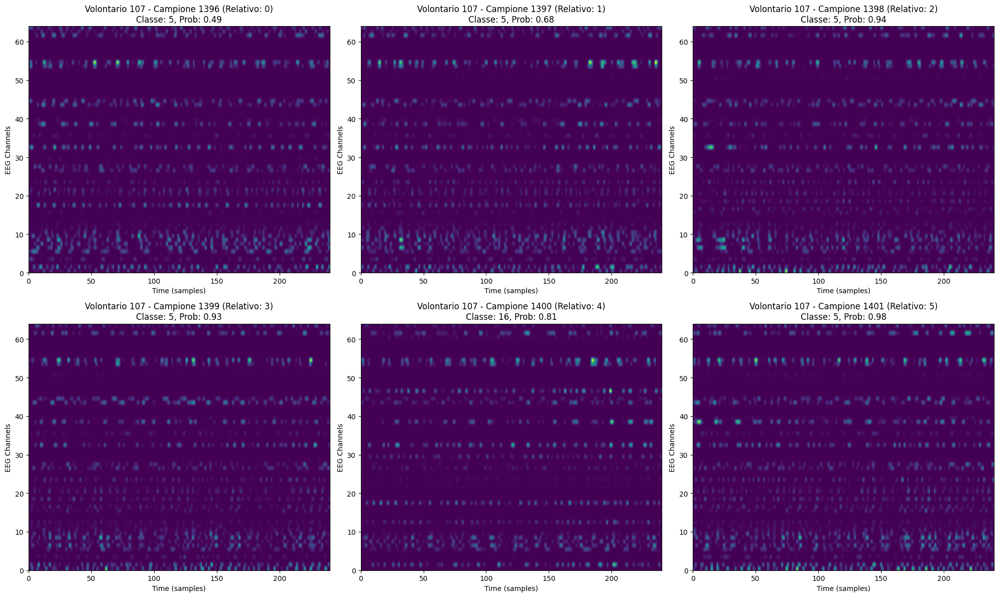

In [ ]:
#@title Analisi Generale Grad-Cam

# Inizializza un array per tracciare i volontari già utilizzati
volontari_usati = []

# Calcola il numero di righe e colonne
num_colonne = 3
num_righe = (grafici_subplots + num_colonne - 1) // num_colonne  # Calcola righe dinamicamente

# Crea la figura e la matrice di subplot
fig, axes = plt.subplots(num_righe, num_colonne, figsize=(20, num_righe * 6))
axes = axes.flatten()  # Rende l'array di subplot 1D per iterazione

# Conta quanti plot sono stati generati
num_plot = 0

if selezione_modalita == "Singolo":
    # Modalità Singolo: Trova i campioni della classe selezionata
    campioni_volontario = [
        i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == selezione_volontario
    ]
    selezione_campioni = campioni_volontario[:grafici_subplots]  # Prendi i primi N campioni
    campioni_relativi = list(range(len(selezione_campioni)))  # Indici relativi per campioni
else:  # Modalità Multipla
    selezione_campioni = []
    campioni_relativi = []
    volontari_usati = []

    while num_plot < grafici_subplots:
        indice_random = np.random.randint(0, len(labels[selezione_run]))
        label_volontario = labels[selezione_run][indice_random]

        if label_volontario in volontari_usati:
            continue  # Salta se il volontario è già stato usato

        # Aggiungi il volontario e il campione
        volontari_usati.append(label_volontario)
        selezione_campioni.append(indice_random)  # Aggiungi il campione alla lista
        campioni_relativi.append(0)  # Indice relativo è 0 per il primo campione
        num_plot += 1  # Incrementa il contatore dei plot

# Loop per i campioni selezionati
for idx, (campione_idx, campione_relativo) in enumerate(zip(selezione_campioni, campioni_relativi)):
    # Prepara l'input
    volontario_target = data[selezione_run][campione_idx]
    volontario_target_label = labels[selezione_run][campione_idx]
    volontario_target = np.expand_dims(volontario_target, axis=0)

    # Calcola Grad-CAM
    cam_output = grad_cam_1d(selezione_modello, volontario_target, volontario_target_label, target_layer_name)

    # Calcola la predizione del modello
    predizione = selezione_modello.predict(volontario_target)
    predizione_classe = np.argmax(predizione)  # Classe predetta
    predizione_prob = np.max(predizione)  # Probabilità della classe predetta

    # Determina la posizione nella matrice di plot
    ax = axes[idx]

    # Visualizza la heatmap per il campione corrente
    ax.imshow(cam_output, aspect='auto', cmap='viridis', extent=[0, 240, 0, 64])


    # Aggiungi titolo al subplot con predizione
    ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

    ax.set_xlabel("Time (samples)")
    ax.set_ylabel("EEG Channels")

    # Incrementa il contatore dei plot
    num_plot += 1
clear_output(wait=True)
# Rimuovi subplot vuoti
for ax in axes[len(selezione_campioni):]:
    fig.delaxes(ax)

# Migliora il layout della matrice di plot
plt.tight_layout()
plt.show()

---

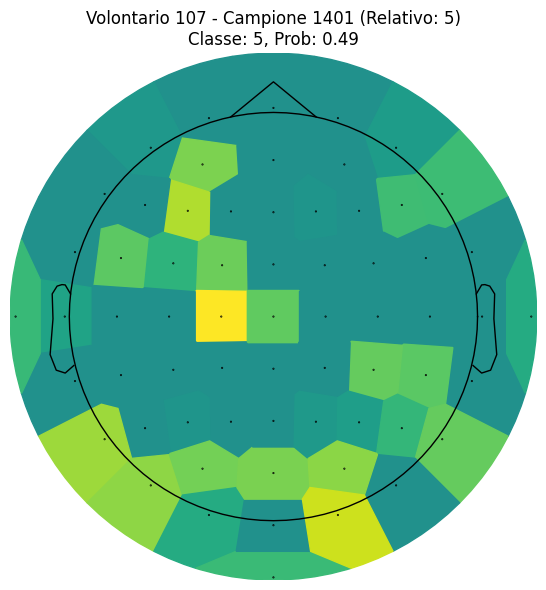

In [ ]:
#@title Heatmap EEG del primo campione del volontario selezionato

# Ottieni il volontario selezionato
volontario_target = selezione_volontario

# Filtra i campioni dello stesso volontario
campioni_volontario = [
    i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == volontario_target
]

# Prendi il primo campione disponibile
indice_primo_campione = campioni_volontario[0]

# Prepara l'input
volontario_target_data = data[selezione_run][indice_primo_campione]
volontario_target_label = labels[selezione_run][indice_primo_campione]
volontario_target_data = np.expand_dims(volontario_target_data, axis=0)

# Calcola Grad-CAM
cam_output = grad_cam_1d(selezione_modello, volontario_target_data, volontario_target_label, target_layer_name)

# Calcola la predizione del modello
predizione = selezione_modello.predict(volontario_target_data)
predizione_classe = np.argmax(predizione)  # Classe predetta
predizione_prob = np.max(predizione)  # Probabilità della classe predetta

# Monta l'oggetto evoked
evoked_montage = get_evoked_montage(cam_output)

# Plot della mappa topografica con titolo personalizzato
fig, ax = plt.subplots(figsize=(6, 6))
evoked_montage.plot_topomap(
    times=[0], size=3, axes=ax, ch_type='eeg', cmap="viridis",
    image_interp="nearest", contours=0, colorbar=False, show=False
)
# Aggiungi titolo con le informazioni del campione
ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

clear_output(wait=True)
plt.tight_layout()
plt.show()


In [36]:
#@title Video completo della stessa heatmap EEG

# Monta l'oggetto evoked
evoked_montage = get_evoked_montage(cam_output, media=False)
n_times = cam_output.shape[1]  # Numero di campioni temporali
times = np.linspace(0, n_times - 1, n_times)

# Informazioni statiche per il titolo
volontario_info = (f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

# Durata dell'animazione in secondi
duration = 16
frame_rate = len(evoked_montage.times) / duration  # Calcolo del frame rate

# Crea la figura per l'animazione
fig, ax = plt.subplots(figsize=(6, 6))

# Funzione per aggiornare i frame
def update_topomap(frame):
    ax.clear()
    evoked_montage.plot_topomap(
        times=[times[frame]], axes=ax, size=3, ch_type='eeg', cmap="viridis",
        image_interp="nearest", contours=0, colorbar=False, show=False
    )
    # Aggiungi titolo con informazioni statiche
    ax.set_title(volontario_info, fontsize=12)

# Crea l'animazione
ani = FuncAnimation(fig, update_topomap, frames=n_times, interval=1000 / frame_rate)

# Mostra l'animazione direttamente nel notebook
HTML_output = HTML(ani.to_jshtml())
plt.close(fig)  # Evita di visualizzare un'immagine statica
display(HTML_output)


In [37]:
#@title Salvataggio dell'animazione
video_path = f"animazione_topomap_{selezione_run}_{selezione_volontario}.mp4"
ani.save(video_path, writer="ffmpeg", fps=15, extra_args=["-preset", "fast"])

---

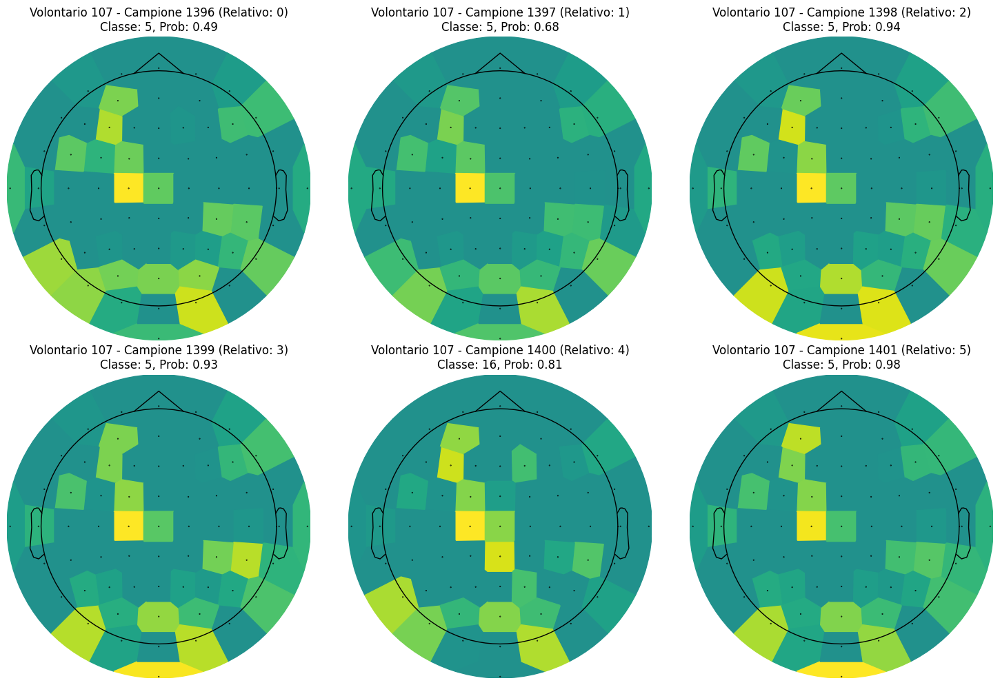

In [38]:
#@title Grafici Multi-Heatmaps
# Modalità Singolo
if selezione_modalita == "Singolo":
    # Trova i campioni appartenenti alla classe selezionata
    campioni_volontario = [
        i for i in range(len(labels[selezione_run])) if labels[selezione_run][i] == selezione_volontario
    ]
    selezione_campioni = campioni_volontario[:grafici_subplots]  # Prendi i primi N campioni
    campioni_relativi = list(range(len(selezione_campioni)))  # Indici relativi sono sequenziali
else:  # Modalità Multipla
    # Prendi i primi N volontari diversi
    volontari_unici = np.unique(labels[selezione_run])
    selezione_volontari = volontari_unici[:grafici_subplots]
    selezione_campioni = []
    campioni_relativi = []
    for volontario in selezione_volontari:
        # Trova tutti i campioni per questo volontario
        campioni_per_classe = np.where(labels[selezione_run] == volontario)[0]
        selezione_campioni.append(campioni_per_classe[0])  # Prendi il primo campione
        campioni_relativi.append(0)  # Il primo campione relativo alla classe è 0

# Calcola il numero di righe e colonne per il subplot
n_cols = 3
n_rows = (len(selezione_campioni) + n_cols - 1) // n_cols  # Numero di righe

# Crea una griglia di subplot
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Rende la matrice degli assi 1D

# Loop sui campioni selezionati
for idx, (campione_idx, campione_relativo) in enumerate(zip(selezione_campioni, campioni_relativi)):
    # Prepara l'input
    volontario_target = data[selezione_run][campione_idx]
    volontario_target_label = labels[selezione_run][campione_idx]
    volontario_target = np.expand_dims(volontario_target, axis=0)

    # Calcola Grad-CAM
    cam_output = grad_cam_1d(selezione_modello, volontario_target, volontario_target_label, target_layer_name)

    # Calcola la predizione del modello
    predizione = selezione_modello.predict(volontario_target)
    predizione_classe = np.argmax(predizione)  # Classe predetta
    predizione_prob = np.max(predizione)  # Probabilità della classe predetta

    # Crea l'oggetto Evoked con montaggio
    evoked_montage = get_evoked_montage(cam_output)

    # Ottieni l'asse corrente
    ax = axes[idx]

    # Visualizza la mappa topografica sul subplot corrente
    evoked_montage.plot_topomap(
        times=[0], size=3, axes=ax, ch_type="eeg",
        cmap="viridis", image_interp="nearest", contours=0, colorbar=False, show=False
    )

    # Aggiungi titolo al subplot con predizione
    ax.set_title(f"Volontario {volontario_target_label} - Campione {campione_idx} (Relativo: {campione_relativo})\n"
                 f"Classe: {predizione_classe}, Prob: {predizione_prob:.2f}")

# Rimuovi subplot vuoti
for ax in axes[len(selezione_campioni):]:
    fig.delaxes(ax)
clear_output(wait=True)
plt.tight_layout()
plt.show()